<a href="https://colab.research.google.com/github/Pyroxene889/Store-Sales/blob/Ikram/sales_RL_RF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [29]:
!git clone https://github.com/Pyroxene889/Store-Sales

fatal: destination path 'Store-Sales' already exists and is not an empty directory.


In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot

In [31]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [32]:
df_train = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Cas_Etude/data_train.csv')

In [33]:
df_test = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Cas_Etude/data_test.csv')

# Data Visualization


In [34]:
fig_type_holiday = px.histogram(df_train, x = "type_holiday", color = "type_holiday", template = "plotly_dark")
fig_type_holiday.show()

In [35]:
# Conversion de la variable type_batiment en une variable binaire
new_df_train = df_train.copy()
new_df_test = df_test.copy()
new_df_train['type_holiday'] = new_df_train['type_holiday'].map({'work': 0, 'Holiday':1,'Work Day': 2, 'Additional':3, 'Event':4, 'Transfer':5, 'Bridge':6})
new_df_test['type_holiday'] = new_df_test['type_holiday'].map({'work': 0, 'Holiday':1,'Work Day': 2, 'Additional':3, 'Event':4, 'Transfer':5, 'Bridge':6})
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,D,1,1,National,93.14,770
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,D,1,1,National,93.14,770


In [36]:
# Conversion de la variable type_batiment en une variable binaire
new_df_train['locale'] = new_df_train['locale'].map({'National': 0, 'Regional':1,'Local': 2})
new_df_test['locale'] = new_df_test['locale'].map({'National': 0, 'Regional':1,'Local': 2})
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,D,1,1,0,93.14,770
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,D,1,1,0,93.14,770


In [37]:
fig_type_store = px.histogram(df_train, x = "type_store", color = "type_store", template = "plotly_dark")
fig_type_store.show()

In [38]:
# Conversion de la variable type_batiment en une variable binaire
new_df_train['type_store'] = new_df_train['type_store'].map({'A': 0, 'B':1,'C': 2, 'D':3, 'E':4})
new_df_test['type_store'] = new_df_test['type_store'].map({'A': 0, 'B':1,'C': 2, 'D':3, 'E':4})
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,3,1,1,0,93.14,770


In [39]:
new_df_test.head()

,date,store_nbr,family,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico
0,2017-08-16,1,AUTOMOTIVE,0,Quito,Pichincha,3,13,0,0,46.8
1,2017-08-16,42,CELEBRATION,0,Cuenca,Azuay,3,2,0,0,46.8
2,2017-08-16,42,BREAD/BAKERY,12,Cuenca,Azuay,3,2,0,0,46.8
3,2017-08-16,42,BOOKS,0,Cuenca,Azuay,3,2,0,0,46.8
4,2017-08-16,42,BEVERAGES,19,Cuenca,Azuay,3,2,0,0,46.8


In [40]:
from sklearn.preprocessing import LabelEncoder

# Initialisez le codage
encoder = LabelEncoder()

# Appliquez le codage à la colonne 'family'
new_df_train['family_encoded'] = encoder.fit_transform(new_df_train['family'])
new_df_train['date_encoded'] = encoder.fit_transform(new_df_train['date'])

new_df_test['family_encoded'] = encoder.fit_transform(new_df_test['family'])
new_df_test['date_encoded'] = encoder.fit_transform(new_df_test['date'])

# Afficher les valeurs codées
#print(new_df_train['family_encoded'].value_counts())


In [41]:
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions,family_encoded,date_encoded
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,0,0
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,32,0
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,31,0
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,30,0
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,3,1,1,0,93.14,770,29,0


In [42]:
new_df_test.head()

,date,store_nbr,family,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,family_encoded,date_encoded
0,2017-08-16,1,AUTOMOTIVE,0,Quito,Pichincha,3,13,0,0,46.8,0,0
1,2017-08-16,42,CELEBRATION,0,Cuenca,Azuay,3,2,0,0,46.8,6,0
2,2017-08-16,42,BREAD/BAKERY,12,Cuenca,Azuay,3,2,0,0,46.8,5,0
3,2017-08-16,42,BOOKS,0,Cuenca,Azuay,3,2,0,0,46.8,4,0
4,2017-08-16,42,BEVERAGES,19,Cuenca,Azuay,3,2,0,0,46.8,3,0


## Correlation

In [43]:
new_df_train = new_df_train.reset_index(drop = True)
new_df_train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type_store,cluster,type_holiday,locale,dcoilwtico,transactions,family_encoded,date_encoded
0,2013-01-01,25,AUTOMOTIVE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,0,0
1,2013-01-01,25,SEAFOOD,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,32,0
2,2013-01-01,25,SCHOOL AND OFFICE SUPPLIES,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,31,0
3,2013-01-01,25,PRODUCE,0.000,0,Salinas,Santa Elena,3,1,1,0,93.14,770,30,0
4,2013-01-01,25,PREPARED FOODS,37.847,0,Salinas,Santa Elena,3,1,1,0,93.14,770,29,0


In [56]:
df_qualitatif_train = new_df_train.drop(["date", "state", "city", "family", "cluster", "store_nbr", "locale", "transactions"], axis = 1)
new_df_train = new_df_train.reset_index(drop = True)
cor = df_qualitatif_train.corr()

In [57]:
df_qualitatif_test = new_df_test.drop(["date", "state", "city", "family", "cluster", "store_nbr", "locale"], axis = 1)

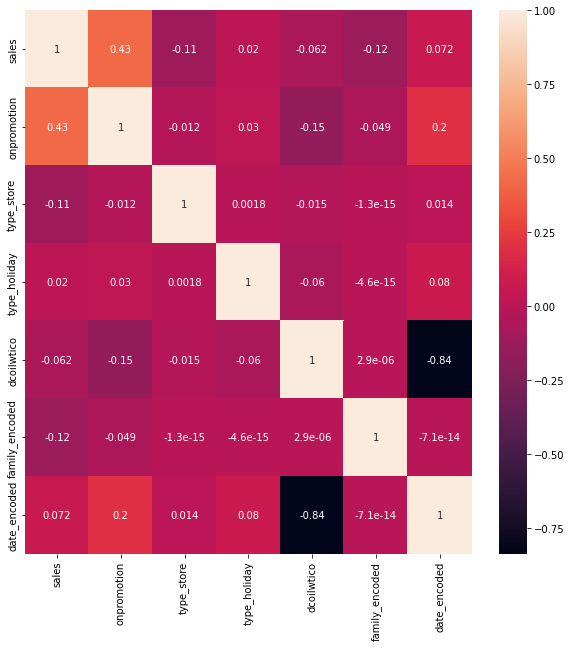

In [58]:
plt.figure(figsize = (10, 10))
sns.heatmap(cor, annot = True)

In [47]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Régression Linéaire

## Entraînement avec les variables explicatives suivantes:


*   date_encoded
*   family_encoded
*   onpromotion
*   transaction
*   type_holiday
*   dcoilwtico
*   type_store











In [59]:
df_qualitatif_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2805231 entries, 0 to 2805230
Data columns (total 7 columns):
 #   Column          Dtype  
---  ------          -----  
 0   sales           float64
 1   onpromotion     int64  
 2   type_store      int64  
 3   type_holiday    int64  
 4   dcoilwtico      float64
 5   family_encoded  int64  
 6   date_encoded    int64  
dtypes: float64(2), int64(5)
memory usage: 149.8 MB


In [60]:
# Séparer les données en entrées (X) et sorties (y)
X = df_qualitatif_train.drop(columns=["sales"])
y = df_qualitatif_train.reset_index(drop = True)["sales"]

# Séparer les données en ensembles d'entraînement et de validation
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)

# Entraîner le modèle de régression linéaire multiple
regressor = LinearRegression()
regressor.fit(X_train, y_train)

# Effectuer des prédictions sur l'ensemble de validation
y_pred = regressor.predict(X_val)



In [61]:
y_val.describe()

count    561047.000000
mean        389.073945
std        1136.388830
min           0.000000
25%           0.000000
50%          17.000000
75%         231.000000
max       53874.000000
Name: sales, dtype: float64

### Evaluation

In [62]:
print('MSE :', mean_squared_error(y_val, y_pred))
print('RMSE :', np.sqrt(mean_squared_error(y_val, y_pred)))
print('MAE :', mean_absolute_error(y_val, y_pred))
print("R2:", r2_score(y_val, y_pred))

MSE : 1024661.985717156
RMSE : 1012.2558894455275
MAE : 454.5388972228875
R2: 0.2065355273348095


### Application aux données test

In [65]:
X_test = df_qualitatif_test
df_qualitatif_test['sales_pred'] = y_pred = regressor.predict(X_test)

In [66]:
df_qualitatif_test.head()

,onpromotion,type_store,type_holiday,dcoilwtico,family_encoded,date_encoded,sales_pred
0,0,3,0,46.8,0,0,489.096046
1,0,3,0,46.8,6,0,417.678757
2,12,3,0,46.8,5,0,885.752395
3,0,3,0,46.8,4,0,441.484520
4,19,3,0,46.8,3,0,1175.657766


## Entraînement avec les variables explicatives suivantes:


*   date_encoded
*   family_encoded
*   onpromotion

In [63]:
X1 = df_qualitatif_train[["date_encoded", "family_encoded", "onpromotion"]]
X1_train, X1_val, y1_train, y1_val = train_test_split(X1, y, test_size=0.2)
regressor1 = LinearRegression()
regressor1.fit(X1_train, y1_train)
y1_pred = regressor1.predict(X1_val)


### Evaluation:

In [64]:
print('MSE :', mean_squared_error(y1_val, y1_pred))
print('RMSE :', np.sqrt(mean_squared_error(y1_val, y1_pred)))
print('MAE :', mean_absolute_error(y1_val, y1_pred))
print("R2:", r2_score(y1_val, y1_pred))

MSE : 1058564.72382395
RMSE : 1028.8657462584465
MAE : 455.3475048300006
R2: 0.19362934586285208


***Remarque***:
On remarque que l'entrînement avec l'ensemble des variables explicatives donne de meilleurs résultats que l'entraînement avec les 3 variables.

### Application à notre modèle

In [69]:
X1_test = df_qualitatif_test[["date_encoded", "family_encoded", "onpromotion"]]
df_qualitatif_test['sales_pred'] = y_pred = regressor1.predict(X1_test)

In [70]:
df_qualitatif_test.head()

,onpromotion,type_store,type_holiday,dcoilwtico,family_encoded,date_encoded,sales_pred
0,0,3,0,46.8,0,0,500.716091
1,0,3,0,46.8,6,0,429.742378
2,12,3,0,46.8,5,0,899.678073
3,0,3,0,46.8,4,0,453.400282
4,19,3,0,46.8,3,0,1190.564910


# Random Forest

## Training

In [67]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [113]:
# Entraînement du modèle Random Forest
model = RandomForestRegressor(n_estimators=50, random_state=0)
model.fit(X_train, y_train)

# Prédiction sur les données de test
y_pred_RF = model.predict(X_val)


## Evaluation

Mean Squared Error: 236386.44921817648
RMSE : 486.19589592897273
MAE : 135.70176786193258
R2 Score: 0.8169501241496513


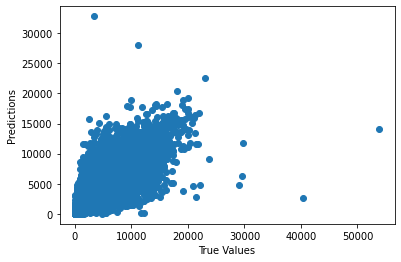

In [114]:
# Évaluation du modèle
mse = mean_squared_error(y_val, y_pred_RF)
r2 = r2_score(y_val, y_pred_RF)

# Afficher les résultats
print('Mean Squared Error:', mse)
print('RMSE :', np.sqrt(mean_squared_error(y_val, y_pred_RF)))
print('MAE :', mean_absolute_error(y_val, y_pred_RF))
print('R2 Score:', r2)


# Visualisation des résultats avec un graphe
plt.scatter(y_val, y_pred_RF)
plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.show()

## Application aux données test

In [ ]:
df_qualitatif_test.info()

In [122]:
X_test = df_qualitatif_test.drop(["sales_pred"], axis =1)
y_pre_rf_test = model.predict(X_test)
df_qualitatif_test['sales_pred_RF'] = y_pre_rf_test

In [123]:
df_qualitatif_test.head()

,onpromotion,type_store,type_holiday,dcoilwtico,family_encoded,date_encoded,sales_pred,sales_pred_RF
0,0,3,0,46.8,0,0,500.716091,4.942996
1,0,3,0,46.8,6,0,429.742378,0.000000
2,12,3,0,46.8,5,0,899.678073,589.367753
3,0,3,0,46.8,4,0,453.400282,0.000000
4,19,3,0,46.8,3,0,1190.564910,3789.870000


In [131]:
df_sample_submission = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Cas_Etude/sample_submission.csv')

In [132]:
df_sample_submission = df_sample_submission.sort_index()
df_sample_submission = df_sample_submission.reset_index(drop=True)

In [133]:
df_sample_submission["sales"]= y_pre_rf_test
df_sample_submission.head()

,id,sales
0,3000888,4.942996
1,3000889,0.000000
2,3000890,589.367753
3,3000891,0.000000
4,3000892,3789.870000


In [134]:
# Convert the DataFrame to a CSV file
df_sample_submission.to_csv('sample_submission.csv', index=False)

# Download the CSV file
from google.colab import files
files.download('sample_submission.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>